# Installing & Importing Libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install keract
import keract

In [ ]:
import pickle
import numpy as np
import pandas as pd
from PIL import Image
import albumentations as A
from IPython.display import SVG
import matplotlib.pyplot as plt
%matplotlib inline
import os, re, sys, random, shutil, cv2

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam, Nadam
from tensorflow.keras import applications, optimizers
from tensorflow.keras.applications.resnet50 import preprocess_input

from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import model_to_dot, plot_model
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, CSVLogger, LearningRateScheduler
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, ZeroPadding2D, Dropout

# Working with Augmented Dataset

In [ ]:
# train_images = "../input/augmented-dubai-aerial-imagery-dataset/train_images/"
# train_masks = "../input/augmented-dubai-aerial-imagery-dataset/train_masks/"
# val_images = "../input/augmented-dubai-aerial-imagery-dataset/val_images/"
# val_masks = "../input/augmented-dubai-aerial-imagery-dataset/val_masks/"
train_images = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/train_images/"
train_masks = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/train_masks/"
val_images = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/val_images/"
val_masks = "/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/val_masks/"

In [ ]:
file_names = np.sort(os.listdir(train_images + 'train/'))
file_names = np.char.split(file_names, '.')
filenames = np.array([])
for i in range(len(file_names)):
    filenames = np.append(filenames, file_names[i][0])

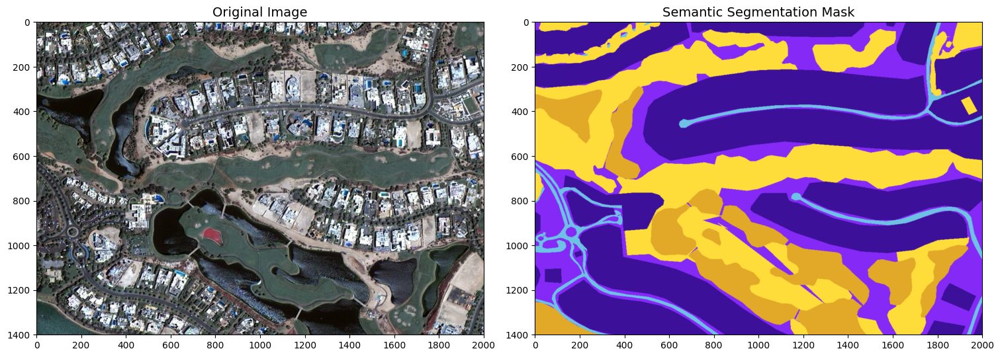

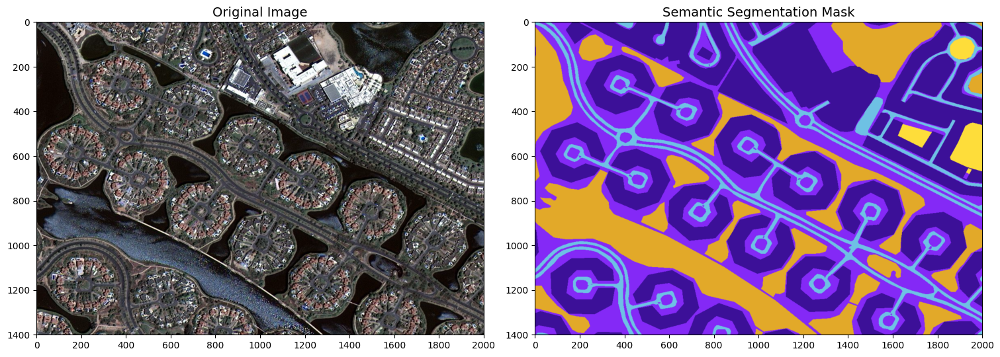

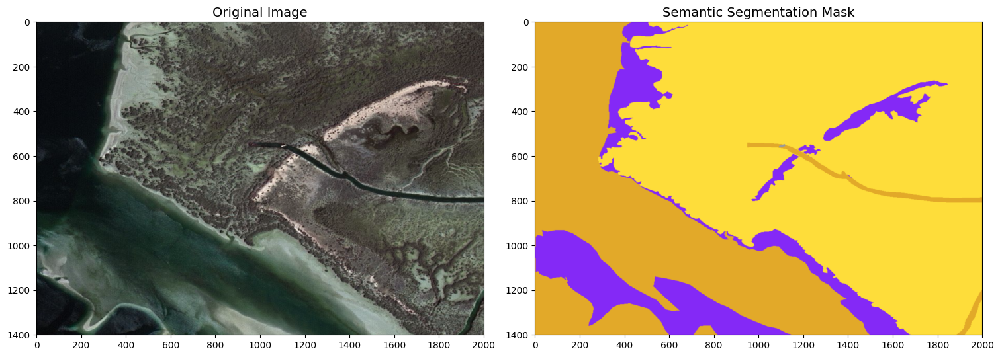

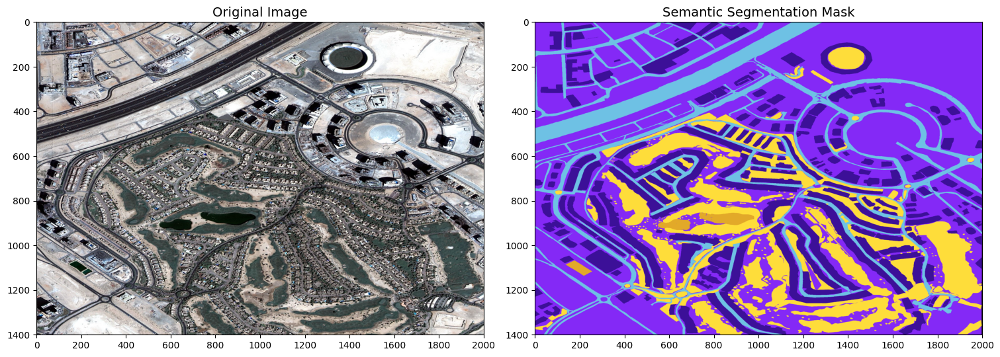

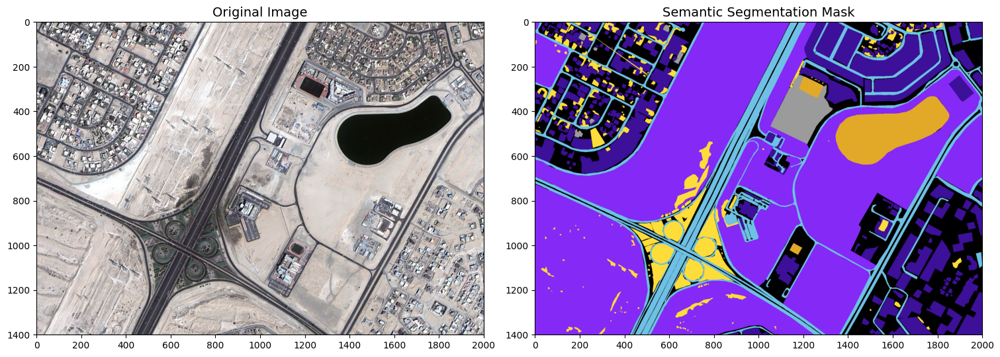

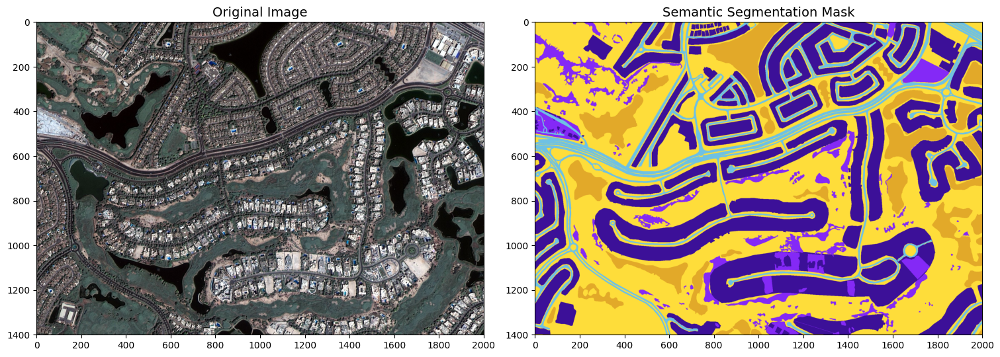

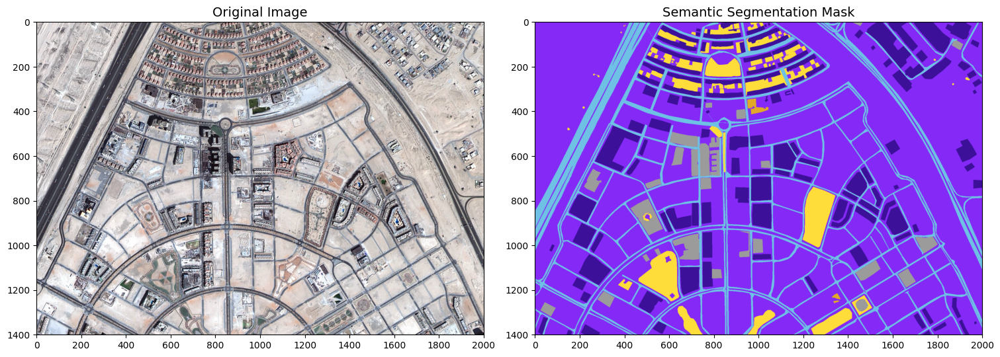

In [ ]:
def show_data(files, original_images_dir, label_images_dir):

    for file in files:
        fig, axs = plt.subplots(1, 2, figsize=(15, 6), constrained_layout=True)

        axs[0].imshow(cv2.resize(cv2.imread(original_images_dir+'train/'+str(file)+'.jpg'), (2000,1400)))
        axs[0].set_title('Original Image', fontdict = {'fontsize':14, 'fontweight': 'medium'})
        axs[0].set_xticks(np.arange(0, 2001, 200))
        axs[0].set_yticks(np.arange(0, 1401, 200))
        axs[0].grid(False)
        axs[0].axis(True)

        semantic_label_image = cv2.imread(label_images_dir+ 'train/'+str(file)+'.png')
        semantic_label_image = cv2.cvtColor(semantic_label_image, cv2.COLOR_BGR2RGB)
        semantic_label_image = cv2.resize(semantic_label_image, (2000,1400))
        axs[1].imshow(semantic_label_image)
        axs[1].set_title('Semantic Segmentation Mask', fontdict = {'fontsize':14, 'fontweight': 'medium'})
        axs[1].set_xticks(np.arange(0, 2001, 200))
        axs[1].set_yticks(np.arange(0, 1401, 200))
        axs[1].grid(False)
        axs[1].axis(True)

        plt.savefig('./sample_'+file, facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 100)
        plt.show()


files = ['image_t4_003', 'image_t4_005', 'image_t6_002', 'image_t7_002', 'image_t8_003', 'image_t8_004', 'image_t8_006']
show_data(files, train_images, train_masks)

In [ ]:
import numpy as np
import pandas as pd

# Define class colors
class_building = '#3C1098'
class_building = class_building.lstrip('#')
class_building = np.array(tuple(int(class_building[i:i+2], 16) for i in (0,2,4)))

class_land = '#8429F6'
class_land = class_land.lstrip('#')
class_land = np.array(tuple(int(class_land[i:i+2], 16) for i in (0,2,4)))

class_road = '#6EC1E4'
class_road = class_road.lstrip('#')
class_road = np.array(tuple(int(class_road[i:i+2], 16) for i in (0,2,4)))

class_vegetation = '#FEDD3A'
class_vegetation = class_vegetation.lstrip('#')
class_vegetation = np.array(tuple(int(class_vegetation[i:i+2], 16) for i in (0,2,4)))

class_water = '#E2A929'
class_water = class_water.lstrip('#')
class_water = np.array(tuple(int(class_water[i:i+2], 16) for i in (0,2,4)))

class_unlabeled = '#9B9B9B'
class_unlabeled = class_unlabeled.lstrip('#')
class_unlabeled = np.array(tuple(int(class_unlabeled[i:i+2], 16) for i in (0,2,4)))

# Create DataFrame
data = {
    'name': ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'],
    'r': [class_building[0], class_land[0], class_road[0], class_vegetation[0], class_water[0], class_unlabeled[0]],
    'g': [class_building[1], class_land[1], class_road[1], class_vegetation[1], class_water[1], class_unlabeled[1]],
    'b': [class_building[2], class_land[2], class_road[2], class_vegetation[2], class_water[2], class_unlabeled[2]]
}

df = pd.DataFrame(data)

# Save DataFrame to CSV
df.to_csv('class_colors.csv', index=False)


In [ ]:
class_dict_df = pd.read_csv('/content/class_colors.csv', index_col=False, skipinitialspace=True)
class_dict_df

,name,r,g,b
0,building,60,16,152
1,land,132,41,246
2,road,110,193,228
3,vegetation,254,221,58
4,water,226,169,41
5,unlabeled,155,155,155


In [ ]:
label_names= list(class_dict_df.name)
label_codes = []
r= np.asarray(class_dict_df.r)
g= np.asarray(class_dict_df.g)
b= np.asarray(class_dict_df.b)

for i in range(len(class_dict_df)):
    label_codes.append(tuple([r[i], g[i], b[i]]))

label_codes, label_names

([(60, 16, 152),
  (132, 41, 246),
  (110, 193, 228),
  (254, 221, 58),
  (226, 169, 41),
  (155, 155, 155)],
 ['building', 'land', 'road', 'vegetation', 'water', 'unlabeled'])

# Create Useful Label & Code Conversion Dictionaries

These will be used for:

* One hot encoding the mask labels for model training
* Decoding the predicted labels for interpretation and visualization

In [ ]:
code2id = {v:k for k,v in enumerate(label_codes)}
id2code = {k:v for k,v in enumerate(label_codes)}

name2id = {v:k for k,v in enumerate(label_names)}
id2name = {k:v for k,v in enumerate(label_names)}

In [ ]:
id2code

{0: (60, 16, 152),
 1: (132, 41, 246),
 2: (110, 193, 228),
 3: (254, 221, 58),
 4: (226, 169, 41),
 5: (155, 155, 155)}

In [ ]:
id2name

{0: 'building',
 1: 'land',
 2: 'road',
 3: 'vegetation',
 4: 'water',
 5: 'unlabeled'}

# Define Functions for One Hot Encoding RGB Labels & Decoding Encoded Predictions

In [ ]:
def rgb_to_onehot(rgb_image, colormap = id2code):
    '''Function to one hot encode RGB mask labels
        Inputs:
            rgb_image - image matrix (eg. 256 x 256 x 3 dimension numpy ndarray)
            colormap - dictionary of color to label id
        Output: One hot encoded image of dimensions (height x width x num_classes) where num_classes = len(colormap)
    '''
    num_classes = len(colormap)
    shape = rgb_image.shape[:2]+(num_classes,)
    encoded_image = np.zeros( shape, dtype=np.int8 )
    for i, cls in enumerate(colormap):
        encoded_image[:,:,i] = np.all(rgb_image.reshape( (-1,3) ) == colormap[i], axis=1).reshape(shape[:2])
    return encoded_image


def onehot_to_rgb(onehot, colormap = id2code):
    '''Function to decode encoded mask labels
        Inputs:
            onehot - one hot encoded image matrix (height x width x num_classes)
            colormap - dictionary of color to label id
        Output: Decoded RGB image (height x width x 3)
    '''
    single_layer = np.argmax(onehot, axis=-1)
    output = np.zeros( onehot.shape[:2]+(3,) )
    for k in colormap.keys():
        output[single_layer==k] = colormap[k]
    return np.uint8(output)

# Creating Custom Image Data Generators
## Defining Data Generators

In [ ]:
# Normalizing only frame images, since masks contain label info
data_gen_args = dict(rescale=1./255)
mask_gen_args = dict()

train_frames_datagen = ImageDataGenerator(**data_gen_args)
train_masks_datagen = ImageDataGenerator(**mask_gen_args)
val_frames_datagen = ImageDataGenerator(**data_gen_args)
val_masks_datagen = ImageDataGenerator(**mask_gen_args)

# Seed defined for aligning images and their masks
seed = 1

# Custom Image Data Generators for Creating Batches of Frames and Masks

In [ ]:
def TrainAugmentGenerator(train_images_dir, train_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
    '''Train Image data generator
        Inputs:
            seed - seed provided to the flow_from_directory function to ensure aligned data flow
            batch_size - number of images to import at a time
            train_images_dir - train images directory
            train_masks_dir - train masks directory
            target_size - tuple of integers (height, width)

        Output: Decoded RGB image (height x width x 3)
    '''
    train_image_generator = train_frames_datagen.flow_from_directory(
    train_images_dir,
    batch_size = batch_size,
    seed = seed,
    target_size = target_size)

    train_mask_generator = train_masks_datagen.flow_from_directory(
    train_masks_dir,
    batch_size = batch_size,
    seed = seed,
    target_size = target_size)

    while True:
        X1i = train_image_generator.next()
        X2i = train_mask_generator.next()

        #One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)

def ValAugmentGenerator(val_images_dir, val_masks_dir, seed = 1, batch_size = 8, target_size = (512, 512)):
    '''Validation Image data generator
        Inputs:
            seed - seed provided to the flow_from_directory function to ensure aligned data flow
            batch_size - number of images to import at a time
            val_images_dir - validation images directory
            val_masks_dir - validation masks directory
            target_size - tuple of integers (height, width)

        Output: Decoded RGB image (height x width x 3)
    '''
    val_image_generator = val_frames_datagen.flow_from_directory(
    val_images_dir,
    batch_size = batch_size,
    seed = seed,
    target_size = target_size)


    val_mask_generator = val_masks_datagen.flow_from_directory(
    val_masks_dir,
    batch_size = batch_size,
    seed = seed,
    target_size = target_size)


    while True:
        X1i = val_image_generator.next()
        X2i = val_mask_generator.next()

        #One hot encoding RGB images
        mask_encoded = [rgb_to_onehot(X2i[0][x,:,:,:], id2code) for x in range(X2i[0].shape[0])]

        yield X1i[0], np.asarray(mask_encoded)

# Model

In [ ]:
batch_size = 16
num_train_samples = len(np.sort(os.listdir(train_images+'train')))
num_val_samples = len(np.sort(os.listdir(val_images+'val')))
steps_per_epoch = np.ceil(float(num_train_samples) / float(batch_size))
print('steps_per_epoch: ', steps_per_epoch)
validation_steps = np.ceil(float(4 * num_val_samples) / float(batch_size))
print('validation_steps: ', validation_steps)

steps_per_epoch:  35.0
validation_steps:  18.0


## VGG19-UNet

In [ ]:
from tensorflow.keras.applications import VGG19
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input, UpSampling2D


def conv_block(input_tensor, num_filters):
    """
    Creates a convolution block with BatchNormalization and ReLU activation.

    Args:
        input_tensor: Input tensor for the block.
        num_filters: Number of filters for the convolution layers.

    Returns:
        Output tensor of the convolution block.
    """
    x = Conv2D(num_filters, 3, padding="same")(input_tensor)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(num_filters, 3, padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    return x


def decoder_block(input_tensor, skip_features, num_filters):
    """
    Creates a decoder block with upsampling, concatenation, and convolution block.

    Args:
        input_tensor: Input tensor for the block.
        skip_features: Feature map from the encoder with the same spatial size.
        num_filters: Number of filters for the convolution layers.

    Returns:
        Output tensor of the decoder block.
    """
    # Use UpSampling2D for compatibility with newer TensorFlow versions
    x = UpSampling2D((2, 2))(input_tensor)
    # x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input_tensor)
    x = Concatenate()([x, skip_features])
    x = conv_block(x, num_filters)
    return x


def build_vgg19_unet(input_shape):
    """
    Builds a VGG19 U-Net model for image segmentation.

    Args:
        input_shape: Shape of the input image (channels, height, width).

    Returns:
        Compiled VGG19 U-Net model.
    """

    inputs = Input(input_shape)

    """ Pre-trained VGG19 Model """
    # Make sure to download and place pre-trained weights in the appropriate location
    encoder = VGG19(include_top=False, weights="imagenet", input_tensor=inputs)

    """ Encoder """
    s1 = encoder.get_layer("block1_conv2").output  ## (height, width, channels)
    s2 = encoder.get_layer("block2_conv2").output
    s3 = encoder.get_layer("block3_conv4").output
    s4 = encoder.get_layer("block4_conv4").output
    s5 = encoder.get_layer("block5_conv4").output

    """ Bridge """
    b1 = encoder.get_layer("block5_conv4").output

    """ Decoder """
    d1 = decoder_block(b1, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    """ Output """
    dropout = Dropout(0.3)(d4)
    outputs = Conv2D(6, 1, padding="same", activation="softmax")(dropout)  # Adjust num_classes based on your problem

    model = Model(inputs, outputs, name="VGG19-UNet")
    return model

In [ ]:
K.clear_session()

def dice_coef(y_true, y_pred):
    return (2. * K.sum(y_true * y_pred) + 1.) / (K.sum(y_true) + K.sum(y_pred) + 1.)

model = build_vgg19_unet(input_shape=(512, 512, 3))
model.compile(optimizer=Adam(lr = 0.0001), loss='categorical_crossentropy', metrics=[dice_coef, "accuracy"])
model.summary()

Model: "VGG19-UNet"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 512, 512, 3)]        0         []                            
                                                                                                  
 block1_conv1 (Conv2D)       (None, 512, 512, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 block1_conv2 (Conv2D)       (None, 512, 512, 64)         36928     ['block1_conv1[0][0]']        
                                                                                                  
 block1_pool (MaxPooling2D)  (None, 256, 256, 64)         0         ['block1_conv2[0][0]']        
                                                                                         

### Model Layout

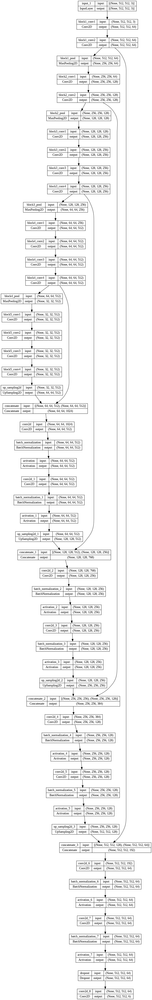

In [ ]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True, expand_nested=True)

# Model Training

In [ ]:
import numpy as np
import tensorflow as tf
from sklearn.metrics import precision_score, recall_score, f1_score

class MetricsCallback(tf.keras.callbacks.Callback):
    def __init__(self, validation_data):
        super(MetricsCallback, self).__init__()
        self.validation_data = validation_data

    def on_epoch_end(self, epoch, logs=None):
        val_preds = self.model.predict(self.validation_data[0])
        val_true = self.validation_data[1]

        val_preds_argmax = np.argmax(val_preds, axis=-1)
        val_true_argmax = np.argmax(val_true, axis=-1)

        val_recall = recall_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')
        val_precision = precision_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')
        val_f1 = f1_score(val_true_argmax.ravel(), val_preds_argmax.ravel(), average='macro')

        print(f' - val_recall: {val_recall:.4f} - val_precision: {val_precision:.4f} - val_f1: {val_f1:.4f}')

In [ ]:
val_data = next(ValAugmentGenerator(val_images_dir=val_images, val_masks_dir=val_masks, target_size=(512, 512)))

# Instantiate the MetricsCallback
metrics_callback = MetricsCallback(validation_data=val_data)

Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.


In [ ]:
def exponential_decay(lr0, s):
    def exponential_decay_fn(epoch):
        return lr0 * 0.1 **(epoch / s)
    return exponential_decay_fn

exponential_decay_fn = exponential_decay(0.0001, 60)

lr_scheduler = LearningRateScheduler(
    exponential_decay_fn,
    verbose=1
)

checkpoint = ModelCheckpoint(
    filepath = 'VGG19_UNet.h5',
    save_best_only = True,
#     save_weights_only = False,
    monitor = 'val_loss',
    mode = 'auto',
    verbose = 1
)

earlystop = EarlyStopping(
    monitor = 'val_loss',
    min_delta = 0.001,
    patience = 12,
    mode = 'auto',
    verbose = 1,
    restore_best_weights = True
)

csvlogger = CSVLogger(
    filename= "model_training.csv",
    separator = ",",
    append = False
)

callbacks = [checkpoint, earlystop, csvlogger, lr_scheduler, metrics_callback]

In [ ]:
history = model.fit(
    TrainAugmentGenerator(train_images_dir = train_images, train_masks_dir = train_masks, target_size = (512, 512)),
    steps_per_epoch=steps_per_epoch,
    validation_data = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512)),
    validation_steps = validation_steps,
    epochs = 50,
    callbacks=callbacks,
    use_multiprocessing=False,
    verbose=1
)

Found 548 images belonging to 1 classes.
Found 548 images belonging to 1 classes.

Epoch 1: LearningRateScheduler setting learning rate to 0.0001.
Epoch 1/50
 6/35 [====>.........................] - ETA: 1:20 - loss: 1.6782 - dice_coef: 0.2792 - accuracy: 0.3973

35/35 [==============================] - ETA: 0s - loss: 1.2422 - dice_coef: 0.4427 - accuracy: 0.5904Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.

Epoch 1: val_loss improved from inf to 4.28577, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 482ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.1920 - val_precision: 0.1319 - val_f1: 0.0853
35/35 [==============================] - 273s 6s/step - loss: 1.2422 - dice_coef: 0.4427 - accuracy: 0.5904 - val_loss: 4.2858 - val_dice_coef: 0.1611 - val_accuracy: 0.1315 - lr: 1.0000e-04

Epoch 2: LearningRateScheduler setting learning rate to 9.623506263980886e-05.
Epoch 2/50
35/35 [==============================] - ETA: 0s - loss: 0.9586 - dice_coef: 0.5481 - accuracy: 0.6951
Epoch 2: val_loss improved from 4.28577 to 3.35439, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 57ms/step
 - val_recall: 0.2714 - val_precision: 0.3542 - val_f1: 0.2112
35/35 [==============================] - 181s 5s/step - loss: 0.9586 - dice_coef: 0.5481 - accuracy: 0.6951 - val_loss: 3.3544 - val_dice_coef: 0.2437 - val_accuracy: 0.2722 - lr: 9.6235e-05

Epoch 3: LearningRateScheduler setting learning rate to 9.261187281287936e-05.
Epoch 3/50
35/35 [==============================] - ETA: 0s - loss: 0.8565 - dice_coef: 0.5838 - accuracy: 0.7290
Epoch 3: val_loss improved from 3.35439 to 1.08564, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step
 - val_recall: 0.5013 - val_precision: 0.5612 - val_f1: 0.4639
35/35 [==============================] - 124s 4s/step - loss: 0.8565 - dice_coef: 0.5838 - accuracy: 0.7290 - val_loss: 1.0856 - val_dice_coef: 0.5081 - val_accuracy: 0.6173 - lr: 9.2612e-05

Epoch 4: LearningRateScheduler setting learning rate to 8.912509381337456e-05.
Epoch 4/50
35/35 [==============================] - ETA: 0s - loss: 0.7970 - dice_coef: 0.6108 - accuracy: 0.7454
Epoch 4: val_loss improved from 1.08564 to 0.91425, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 42ms/step
 - val_recall: 0.5031 - val_precision: 0.5667 - val_f1: 0.4962
35/35 [==============================] - 123s 4s/step - loss: 0.7970 - dice_coef: 0.6108 - accuracy: 0.7454 - val_loss: 0.9142 - val_dice_coef: 0.5435 - val_accuracy: 0.6807 - lr: 8.9125e-05

Epoch 5: LearningRateScheduler setting learning rate to 8.576958985908941e-05.
Epoch 5/50
35/35 [==============================] - ETA: 0s - loss: 0.7499 - dice_coef: 0.6270 - accuracy: 0.7576
Epoch 5: val_loss improved from 0.91425 to 0.77428, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 44ms/step
 - val_recall: 0.5894 - val_precision: 0.6553 - val_f1: 0.5942
35/35 [==============================] - 124s 4s/step - loss: 0.7499 - dice_coef: 0.6270 - accuracy: 0.7576 - val_loss: 0.7743 - val_dice_coef: 0.6478 - val_accuracy: 0.7628 - lr: 8.5770e-05

Epoch 6: LearningRateScheduler setting learning rate to 8.254041852680184e-05.
Epoch 6/50
35/35 [==============================] - ETA: 0s - loss: 0.7326 - dice_coef: 0.6350 - accuracy: 0.7627
Epoch 6: val_loss improved from 0.77428 to 0.77104, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step
 - val_recall: 0.5934 - val_precision: 0.6386 - val_f1: 0.5944
35/35 [==============================] - 118s 3s/step - loss: 0.7326 - dice_coef: 0.6350 - accuracy: 0.7627 - val_loss: 0.7710 - val_dice_coef: 0.6440 - val_accuracy: 0.7697 - lr: 8.2540e-05

Epoch 7: LearningRateScheduler setting learning rate to 7.943282347242815e-05.
Epoch 7/50
35/35 [==============================] - ETA: 0s - loss: 0.6888 - dice_coef: 0.6529 - accuracy: 0.7773
Epoch 7: val_loss improved from 0.77104 to 0.63110, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step
 - val_recall: 0.5915 - val_precision: 0.6332 - val_f1: 0.5929
35/35 [==============================] - 118s 3s/step - loss: 0.6888 - dice_coef: 0.6529 - accuracy: 0.7773 - val_loss: 0.6311 - val_dice_coef: 0.6788 - val_accuracy: 0.7925 - lr: 7.9433e-05

Epoch 8: LearningRateScheduler setting learning rate to 7.644222742526003e-05.
Epoch 8/50
35/35 [==============================] - ETA: 0s - loss: 0.6788 - dice_coef: 0.6603 - accuracy: 0.7787
Epoch 8: val_loss did not improve from 0.63110
1/1 [==============================] - 0s 41ms/step
 - val_recall: 0.6051 - val_precision: 0.6754 - val_f1: 0.6151
35/35 [==============================] - 121s 3s/step - loss: 0.6788 - dice_coef: 0.6603 - accuracy: 0.7787 - val_loss: 0.6425 - val_dice_coef: 0.7085 - val_accuracy: 0.7899 - lr: 7.6442e-05

Epoch 9: LearningRateScheduler setting learning rate to 7.356422544596415e-05.
Epoch 9/50
35/35 [==============================] - ETA: 0s - loss:

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 35ms/step
 - val_recall: 0.6436 - val_precision: 0.6660 - val_f1: 0.6466
35/35 [==============================] - 119s 3s/step - loss: 0.6288 - dice_coef: 0.6817 - accuracy: 0.7988 - val_loss: 0.5509 - val_dice_coef: 0.7130 - val_accuracy: 0.8209 - lr: 7.3564e-05

Epoch 10: LearningRateScheduler setting learning rate to 7.07945784384138e-05.
Epoch 10/50
35/35 [==============================] - ETA: 0s - loss: 0.6319 - dice_coef: 0.6788 - accuracy: 0.7943
Epoch 10: val_loss did not improve from 0.55089
1/1 [==============================] - 0s 41ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.5172 - val_precision: 0.6295 - val_f1: 0.5121
35/35 [==============================] - 116s 3s/step - loss: 0.6319 - dice_coef: 0.6788 - accuracy: 0.7943 - val_loss: 0.7419 - val_dice_coef: 0.6767 - val_accuracy: 0.7487 - lr: 7.0795e-05

Epoch 11: LearningRateScheduler setting learning rate to 6.812920690579614e-05.
Epoch 11/50
35/35 [==============================] - ETA: 0s - loss: 0.6153 - dice_coef: 0.6864 - accuracy: 0.7986
Epoch 11: val_loss improved from 0.55089 to 0.52825, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 44ms/step
 - val_recall: 0.6436 - val_precision: 0.6797 - val_f1: 0.6541
35/35 [==============================] - 119s 3s/step - loss: 0.6153 - dice_coef: 0.6864 - accuracy: 0.7986 - val_loss: 0.5282 - val_dice_coef: 0.7374 - val_accuracy: 0.8273 - lr: 6.8129e-05

Epoch 12: LearningRateScheduler setting learning rate to 6.556418494179789e-05.
Epoch 12/50
35/35 [==============================] - ETA: 0s - loss: 0.5764 - dice_coef: 0.7038 - accuracy: 0.8107
Epoch 12: val_loss did not improve from 0.52825
1/1 [==============================] - 0s 34ms/step
 - val_recall: 0.6546 - val_precision: 0.6706 - val_f1: 0.6583
35/35 [==============================] - 117s 3s/step - loss: 0.5764 - dice_coef: 0.7038 - accuracy: 0.8107 - val_loss: 0.5517 - val_dice_coef: 0.7232 - val_accuracy: 0.8255 - lr: 6.5564e-05

Epoch 13: LearningRateScheduler setting learning rate to 6.309573444801933e-05.
Epoch 13/50
35/35 [==============================] - ETA: 0s - 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 53ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6690 - val_precision: 0.6887 - val_f1: 0.6759
35/35 [==============================] - 124s 4s/step - loss: 0.5620 - dice_coef: 0.7087 - accuracy: 0.8168 - val_loss: 0.5037 - val_dice_coef: 0.7484 - val_accuracy: 0.8386 - lr: 6.3096e-05

Epoch 14: LearningRateScheduler setting learning rate to 6.072021956909886e-05.
Epoch 14/50
35/35 [==============================] - ETA: 0s - loss: 0.5284 - dice_coef: 0.7258 - accuracy: 0.8255
Epoch 14: val_loss did not improve from 0.50366
1/1 [==============================] - 0s 54ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6441 - val_precision: 0.6684 - val_f1: 0.6508
35/35 [==============================] - 117s 3s/step - loss: 0.5284 - dice_coef: 0.7258 - accuracy: 0.8255 - val_loss: 0.5515 - val_dice_coef: 0.7471 - val_accuracy: 0.8211 - lr: 6.0720e-05

Epoch 15: LearningRateScheduler setting learning rate to 5.8434141337351765e-05.
Epoch 15/50
35/35 [==============================] - ETA: 0s - loss: 0.5067 - dice_coef: 0.7328 - accuracy: 0.8334
Epoch 15: val_loss did not improve from 0.50366
1/1 [==============================] - 0s 55ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6051 - val_precision: 0.6608 - val_f1: 0.6033
35/35 [==============================] - 118s 3s/step - loss: 0.5067 - dice_coef: 0.7328 - accuracy: 0.8334 - val_loss: 0.5846 - val_dice_coef: 0.7367 - val_accuracy: 0.8025 - lr: 5.8434e-05

Epoch 16: LearningRateScheduler setting learning rate to 5.623413251903491e-05.
Epoch 16/50
35/35 [==============================] - ETA: 0s - loss: 0.5594 - dice_coef: 0.7174 - accuracy: 0.8155
Epoch 16: val_loss improved from 0.50366 to 0.47372, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6545 - val_precision: 0.6862 - val_f1: 0.6663
35/35 [==============================] - 122s 3s/step - loss: 0.5594 - dice_coef: 0.7174 - accuracy: 0.8155 - val_loss: 0.4737 - val_dice_coef: 0.7754 - val_accuracy: 0.8418 - lr: 5.6234e-05

Epoch 17: LearningRateScheduler setting learning rate to 5.4116952654646367e-05.
Epoch 17/50
35/35 [==============================] - ETA: 0s - loss: 0.5222 - dice_coef: 0.7284 - accuracy: 0.8291
Epoch 17: val_loss did not improve from 0.47372
1/1 [==============================] - 0s 40ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6738 - val_precision: 0.7005 - val_f1: 0.6815
35/35 [==============================] - 119s 3s/step - loss: 0.5222 - dice_coef: 0.7284 - accuracy: 0.8291 - val_loss: 0.4836 - val_dice_coef: 0.7596 - val_accuracy: 0.8391 - lr: 5.4117e-05

Epoch 18: LearningRateScheduler setting learning rate to 5.2079483285954645e-05.
Epoch 18/50
35/35 [==============================] - ETA: 0s - loss: 0.4822 - dice_coef: 0.7483 - accuracy: 0.8434
Epoch 18: val_loss did not improve from 0.47372
1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6790 - val_precision: 0.6863 - val_f1: 0.6795
35/35 [==============================] - 121s 3s/step - loss: 0.4822 - dice_coef: 0.7483 - accuracy: 0.8434 - val_loss: 0.4755 - val_dice_coef: 0.7632 - val_accuracy: 0.8387 - lr: 5.2079e-05

Epoch 19: LearningRateScheduler setting learning rate to 5.011872336272724e-05.
Epoch 19/50
35/35 [==============================] - ETA: 0s - loss: 0.4645 - dice_coef: 0.7551 - accuracy: 0.8471
Epoch 19: val_loss did not improve from 0.47372
1/1 [==============================] - 0s 53ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6737 - val_precision: 0.6857 - val_f1: 0.6736
35/35 [==============================] - 123s 4s/step - loss: 0.4645 - dice_coef: 0.7551 - accuracy: 0.8471 - val_loss: 0.5005 - val_dice_coef: 0.7535 - val_accuracy: 0.8315 - lr: 5.0119e-05

Epoch 20: LearningRateScheduler setting learning rate to 4.8231784822393075e-05.
Epoch 20/50
35/35 [==============================] - ETA: 0s - loss: 0.4594 - dice_coef: 0.7593 - accuracy: 0.8493
Epoch 20: val_loss improved from 0.47372 to 0.42554, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6862 - val_precision: 0.7075 - val_f1: 0.6935
35/35 [==============================] - 122s 4s/step - loss: 0.4594 - dice_coef: 0.7593 - accuracy: 0.8493 - val_loss: 0.4255 - val_dice_coef: 0.7829 - val_accuracy: 0.8564 - lr: 4.8232e-05

Epoch 21: LearningRateScheduler setting learning rate to 4.641588833612779e-05.
Epoch 21/50
35/35 [==============================] - ETA: 0s - loss: 0.4399 - dice_coef: 0.7686 - accuracy: 0.8560
Epoch 21: val_loss did not improve from 0.42554
1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6875 - val_precision: 0.7060 - val_f1: 0.6935
35/35 [==============================] - 123s 4s/step - loss: 0.4399 - dice_coef: 0.7686 - accuracy: 0.8560 - val_loss: 0.4389 - val_dice_coef: 0.7759 - val_accuracy: 0.8557 - lr: 4.6416e-05

Epoch 22: LearningRateScheduler setting learning rate to 4.4668359215096314e-05.
Epoch 22/50
35/35 [==============================] - ETA: 0s - loss: 0.4275 - dice_coef: 0.7764 - accuracy: 0.8587
Epoch 22: val_loss did not improve from 0.42554
1/1 [==============================] - 0s 34ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6813 - val_precision: 0.6956 - val_f1: 0.6865
35/35 [==============================] - 117s 3s/step - loss: 0.4275 - dice_coef: 0.7764 - accuracy: 0.8587 - val_loss: 0.4702 - val_dice_coef: 0.7700 - val_accuracy: 0.8431 - lr: 4.4668e-05

Epoch 23: LearningRateScheduler setting learning rate to 4.298662347082277e-05.
Epoch 23/50
35/35 [==============================] - ETA: 0s - loss: 0.4325 - dice_coef: 0.7693 - accuracy: 0.8568
Epoch 23: val_loss did not improve from 0.42554
1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6800 - val_precision: 0.6830 - val_f1: 0.6752
35/35 [==============================] - 118s 3s/step - loss: 0.4325 - dice_coef: 0.7693 - accuracy: 0.8568 - val_loss: 0.4833 - val_dice_coef: 0.7553 - val_accuracy: 0.8364 - lr: 4.2987e-05

Epoch 24: LearningRateScheduler setting learning rate to 4.136820402388507e-05.
Epoch 24/50
35/35 [==============================] - ETA: 0s - loss: 0.4017 - dice_coef: 0.7874 - accuracy: 0.8696
Epoch 24: val_loss improved from 0.42554 to 0.40088, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 35ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6970 - val_precision: 0.7003 - val_f1: 0.6964
35/35 [==============================] - 117s 3s/step - loss: 0.4017 - dice_coef: 0.7874 - accuracy: 0.8696 - val_loss: 0.4009 - val_dice_coef: 0.7946 - val_accuracy: 0.8656 - lr: 4.1368e-05

Epoch 25: LearningRateScheduler setting learning rate to 3.981071705534973e-05.
Epoch 25/50
35/35 [==============================] - ETA: 0s - loss: 0.3691 - dice_coef: 0.7990 - accuracy: 0.8777
Epoch 25: val_loss did not improve from 0.40088
1/1 [==============================] - 0s 32ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6862 - val_precision: 0.6947 - val_f1: 0.6858
35/35 [==============================] - 122s 4s/step - loss: 0.3691 - dice_coef: 0.7990 - accuracy: 0.8777 - val_loss: 0.4385 - val_dice_coef: 0.7911 - val_accuracy: 0.8551 - lr: 3.9811e-05

Epoch 26: LearningRateScheduler setting learning rate to 3.8311868495572876e-05.
Epoch 26/50
35/35 [==============================] - ETA: 0s - loss: 0.4066 - dice_coef: 0.7868 - accuracy: 0.8642
Epoch 26: val_loss did not improve from 0.40088
1/1 [==============================] - 0s 49ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.6930 - val_precision: 0.6983 - val_f1: 0.6933
35/35 [==============================] - 116s 3s/step - loss: 0.4066 - dice_coef: 0.7868 - accuracy: 0.8642 - val_loss: 0.4218 - val_dice_coef: 0.7898 - val_accuracy: 0.8593 - lr: 3.8312e-05

Epoch 27: LearningRateScheduler setting learning rate to 3.6869450645195756e-05.
Epoch 27/50
35/35 [==============================] - ETA: 0s - loss: 0.3737 - dice_coef: 0.7972 - accuracy: 0.8759
Epoch 27: val_loss did not improve from 0.40088
1/1 [==============================] - 0s 40ms/step
 - val_recall: 0.6919 - val_precision: 0.6915 - val_f1: 0.6871
35/35 [==============================] - 118s 3s/step - loss: 0.3737 - dice_coef: 0.7972 - accuracy: 0.8759 - val_loss: 0.4593 - val_dice_coef: 0.7738 - val_accuracy: 0.8451 - lr: 3.6869e-05

Epoch 28: LearningRateScheduler setting learning rate to 3.548133892335755e-05.
Epoch 28/50
35/35 [==============================] - ETA: 0s - loss: 0.3660 - dice_coef: 0.8027 - accuracy: 0.8793

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 44ms/step


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


 - val_recall: 0.7021 - val_precision: 0.7129 - val_f1: 0.7050
35/35 [==============================] - 122s 4s/step - loss: 0.3660 - dice_coef: 0.8027 - accuracy: 0.8793 - val_loss: 0.3921 - val_dice_coef: 0.8004 - val_accuracy: 0.8692 - lr: 3.5481e-05

Epoch 29: LearningRateScheduler setting learning rate to 3.4145488738336015e-05.
Epoch 29/50
35/35 [==============================] - ETA: 0s - loss: 0.3578 - dice_coef: 0.8059 - accuracy: 0.8780
Epoch 29: val_loss did not improve from 0.39209
1/1 [==============================] - 0s 33ms/step
 - val_recall: 0.7053 - val_precision: 0.7039 - val_f1: 0.7019
35/35 [==============================] - 123s 4s/step - loss: 0.3578 - dice_coef: 0.8059 - accuracy: 0.8780 - val_loss: 0.3968 - val_dice_coef: 0.7928 - val_accuracy: 0.8660 - lr: 3.4145e-05

Epoch 30: LearningRateScheduler setting learning rate to 3.285993247600655e-05.
Epoch 30/50
35/35 [==============================] - ETA: 0s - loss: 0.3431 - dice_coef: 0.8130 - accuracy: 0.8869

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step
 - val_recall: 0.6995 - val_precision: 0.7140 - val_f1: 0.7030
35/35 [==============================] - 122s 3s/step - loss: 0.3431 - dice_coef: 0.8130 - accuracy: 0.8869 - val_loss: 0.3799 - val_dice_coef: 0.8138 - val_accuracy: 0.8746 - lr: 3.2860e-05

Epoch 31: LearningRateScheduler setting learning rate to 3.1622776601683795e-05.
Epoch 31/50
35/35 [==============================] - ETA: 0s - loss: 0.3482 - dice_coef: 0.8105 - accuracy: 0.8827
Epoch 31: val_loss improved from 0.37994 to 0.36324, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 36ms/step
 - val_recall: 0.7121 - val_precision: 0.7166 - val_f1: 0.7132
35/35 [==============================] - 124s 4s/step - loss: 0.3482 - dice_coef: 0.8105 - accuracy: 0.8827 - val_loss: 0.3632 - val_dice_coef: 0.8127 - val_accuracy: 0.8776 - lr: 3.1623e-05

Epoch 32: LearningRateScheduler setting learning rate to 3.0432198871077215e-05.
Epoch 32/50
35/35 [==============================] - ETA: 0s - loss: 0.3255 - dice_coef: 0.8197 - accuracy: 0.8907
Epoch 32: val_loss improved from 0.36324 to 0.33650, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 30ms/step
 - val_recall: 0.7160 - val_precision: 0.7206 - val_f1: 0.7174
35/35 [==============================] - 126s 4s/step - loss: 0.3255 - dice_coef: 0.8197 - accuracy: 0.8907 - val_loss: 0.3365 - val_dice_coef: 0.8272 - val_accuracy: 0.8857 - lr: 3.0432e-05

Epoch 33: LearningRateScheduler setting learning rate to 2.928644564625237e-05.
Epoch 33/50
35/35 [==============================] - ETA: 0s - loss: 0.3241 - dice_coef: 0.8221 - accuracy: 0.8924
Epoch 33: val_loss did not improve from 0.33650
1/1 [==============================] - 0s 31ms/step
 - val_recall: 0.7190 - val_precision: 0.7154 - val_f1: 0.7165
35/35 [==============================] - 122s 4s/step - loss: 0.3241 - dice_coef: 0.8221 - accuracy: 0.8924 - val_loss: 0.3452 - val_dice_coef: 0.8204 - val_accuracy: 0.8834 - lr: 2.9286e-05

Epoch 34: LearningRateScheduler setting learning rate to 2.818382931264454e-05.
Epoch 34/50
35/35 [==============================] - ETA: 0s - 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 35ms/step
 - val_recall: 0.7194 - val_precision: 0.7188 - val_f1: 0.7185
35/35 [==============================] - 126s 4s/step - loss: 0.3120 - dice_coef: 0.8272 - accuracy: 0.8948 - val_loss: 0.3225 - val_dice_coef: 0.8326 - val_accuracy: 0.8909 - lr: 2.7123e-05

Epoch 36: LearningRateScheduler setting learning rate to 2.6101572156825366e-05.
Epoch 36/50
35/35 [==============================] - ETA: 0s - loss: 0.2998 - dice_coef: 0.8326 - accuracy: 0.9015
Epoch 36: val_loss did not improve from 0.32248
1/1 [==============================] - 0s 31ms/step
 - val_recall: 0.7152 - val_precision: 0.7137 - val_f1: 0.7133
35/35 [==============================] - 121s 3s/step - loss: 0.2998 - dice_coef: 0.8326 - accuracy: 0.9015 - val_loss: 0.3480 - val_dice_coef: 0.8281 - val_accuracy: 0.8824 - lr: 2.6102e-05

Epoch 37: LearningRateScheduler setting learning rate to 2.51188643150958e-05.
Epoch 37/50
35/35 [==============================] - ETA: 0s - 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 35ms/step
 - val_recall: 0.7210 - val_precision: 0.7366 - val_f1: 0.7263
35/35 [==============================] - 123s 4s/step - loss: 0.2886 - dice_coef: 0.8395 - accuracy: 0.9028 - val_loss: 0.3219 - val_dice_coef: 0.8430 - val_accuracy: 0.8905 - lr: 2.3263e-05

Epoch 40: LearningRateScheduler setting learning rate to 2.2387211385683396e-05.
Epoch 40/50
35/35 [==============================] - ETA: 0s - loss: 0.2760 - dice_coef: 0.8456 - accuracy: 0.9076
Epoch 40: val_loss did not improve from 0.32193
1/1 [==============================] - 0s 31ms/step
 - val_recall: 0.7242 - val_precision: 0.7451 - val_f1: 0.7288
35/35 [==============================] - 122s 4s/step - loss: 0.2760 - dice_coef: 0.8456 - accuracy: 0.9076 - val_loss: 0.3366 - val_dice_coef: 0.8440 - val_accuracy: 0.8892 - lr: 2.2387e-05

Epoch 41: LearningRateScheduler setting learning rate to 2.154434690031884e-05.
Epoch 41/50
35/35 [==============================] - ETA: 0s -

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 33ms/step
 - val_recall: 0.7391 - val_precision: 0.7644 - val_f1: 0.7430
35/35 [==============================] - 122s 4s/step - loss: 0.2677 - dice_coef: 0.8471 - accuracy: 0.9095 - val_loss: 0.3170 - val_dice_coef: 0.8420 - val_accuracy: 0.8895 - lr: 2.0733e-05

Epoch 43: LearningRateScheduler setting learning rate to 1.99526231496888e-05.
Epoch 43/50
35/35 [==============================] - ETA: 0s - loss: 0.2682 - dice_coef: 0.8500 - accuracy: 0.9099
Epoch 43: val_loss did not improve from 0.31695
1/1 [==============================] - 0s 48ms/step
 - val_recall: 0.7291 - val_precision: 0.7557 - val_f1: 0.7268
35/35 [==============================] - 122s 4s/step - loss: 0.2682 - dice_coef: 0.8500 - accuracy: 0.9099 - val_loss: 0.3301 - val_dice_coef: 0.8382 - val_accuracy: 0.8879 - lr: 1.9953e-05

Epoch 44: LearningRateScheduler setting learning rate to 1.920141938638802e-05.
Epoch 44/50
35/35 [==============================] - ETA: 0s - l

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 31ms/step
 - val_recall: 0.7371 - val_precision: 0.7456 - val_f1: 0.7392
35/35 [==============================] - 121s 3s/step - loss: 0.2574 - dice_coef: 0.8508 - accuracy: 0.9137 - val_loss: 0.3154 - val_dice_coef: 0.8543 - val_accuracy: 0.8944 - lr: 1.9201e-05

Epoch 45: LearningRateScheduler setting learning rate to 1.8478497974222914e-05.
Epoch 45/50
35/35 [==============================] - ETA: 0s - loss: 0.2516 - dice_coef: 0.8573 - accuracy: 0.9160
Epoch 45: val_loss improved from 0.31543 to 0.30808, saving model to VGG19_UNet.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 32ms/step
 - val_recall: 0.7296 - val_precision: 0.7659 - val_f1: 0.7311
35/35 [==============================] - 125s 4s/step - loss: 0.2516 - dice_coef: 0.8573 - accuracy: 0.9160 - val_loss: 0.3081 - val_dice_coef: 0.8493 - val_accuracy: 0.8942 - lr: 1.8478e-05

Epoch 46: LearningRateScheduler setting learning rate to 1.778279410038923e-05.
Epoch 46/50
35/35 [==============================] - ETA: 0s - loss: 0.2542 - dice_coef: 0.8569 - accuracy: 0.9136
Epoch 46: val_loss did not improve from 0.30808
1/1 [==============================] - 0s 31ms/step
 - val_recall: 0.7528 - val_precision: 0.7846 - val_f1: 0.7607
35/35 [==============================] - 121s 3s/step - loss: 0.2542 - dice_coef: 0.8569 - accuracy: 0.9136 - val_loss: 0.3225 - val_dice_coef: 0.8472 - val_accuracy: 0.8918 - lr: 1.7783e-05

Epoch 47: LearningRateScheduler setting learning rate to 1.711328304161781e-05.
Epoch 47/50
35/35 [==============================] - ETA: 0s - 

In [ ]:
df_result = pd.DataFrame(history.history)
df_result

,loss,dice_coef,accuracy,val_loss,val_dice_coef,val_accuracy,lr
0,1.242220,0.442651,0.590419,4.285765,0.161053,0.131456,0.000100
1,0.958591,0.548139,0.695067,3.354387,0.243706,0.272239,0.000096
2,0.856473,0.583796,0.729031,1.085642,0.508075,0.617251,0.000093
3,0.796971,0.610792,0.745434,0.914248,0.543536,0.680669,0.000089
4,0.749925,0.627004,0.757623,0.774277,0.647780,0.762843,0.000086
5,0.732566,0.635048,0.762681,0.771043,0.643972,0.769657,0.000083
6,0.688752,0.652897,0.777271,0.631096,0.678845,0.792493,0.000079
7,0.678753,0.660316,0.778670,0.642536,0.708507,0.789935,0.000076
8,0.628794,0.681749,0.798827,0.550888,0.712961,0.820930,0.000074
9,0.631872,0.678836,0.794273,0.741912,0.676662,0.748702,0.000071


In [ ]:
df_result.to_csv("VGG19_UNet.csv")

## Training Results

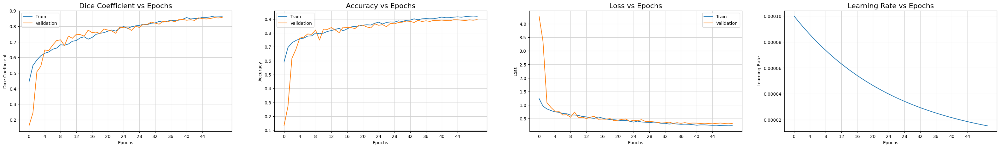

In [ ]:
fig, ax = plt.subplots(1, 4, figsize=(40, 5))
ax = ax.ravel()
metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate']

for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr']):
# metrics = ['Dice Coefficient', 'Accuracy', 'Loss', 'Learning Rate', 'Precision', 'Recall', 'F1 Score']

# for i, met in enumerate(['dice_coef', 'accuracy', 'loss', 'lr', 'recall', 'precision', 'f1']):
    if met != 'lr':
        ax[i].plot(history.history[met])
        ax[i].plot(history.history['val_' + met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,46,4))
        ax[i].legend(['Train', 'Validation'])
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
    else:
        ax[i].plot(history.history[met])
        ax[i].set_title('{} vs Epochs'.format(metrics[i]), fontsize=16)
        ax[i].set_xlabel('Epochs')
        ax[i].set_ylabel(metrics[i])
        ax[i].set_xticks(np.arange(0,46,4))
        ax[i].xaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")
        ax[i].yaxis.grid(True, color = "lightgray", linewidth = "0.8", linestyle = "-")

plt.savefig('model_metrics_plot.png', facecolor= 'w',transparent= False, bbox_inches= 'tight', dpi= 150)

## Predictions

In [ ]:
model.load_weights("./VGG19_UNet.h5")

In [ ]:
testing_gen = ValAugmentGenerator(val_images_dir = val_images, val_masks_dir = val_masks, target_size = (512, 512))

Found 70 images belonging to 1 classes.
Found 70 images belonging to 1 classes.
1/1 [==============================] - 0s 35ms/step


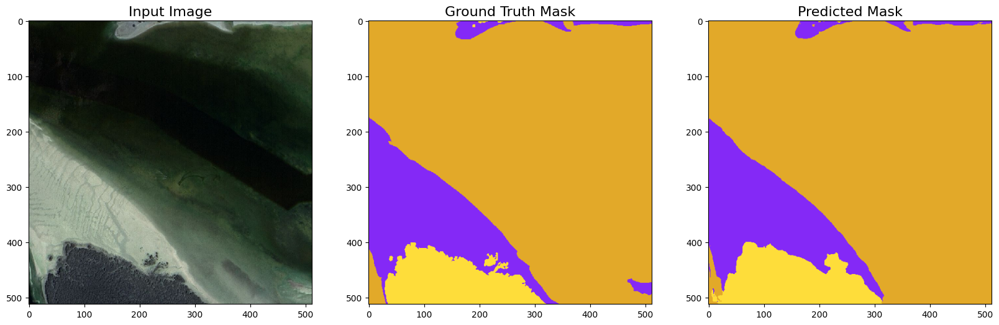

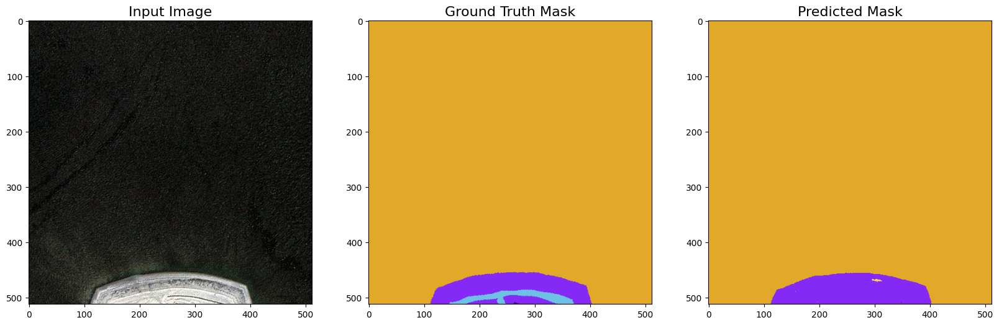

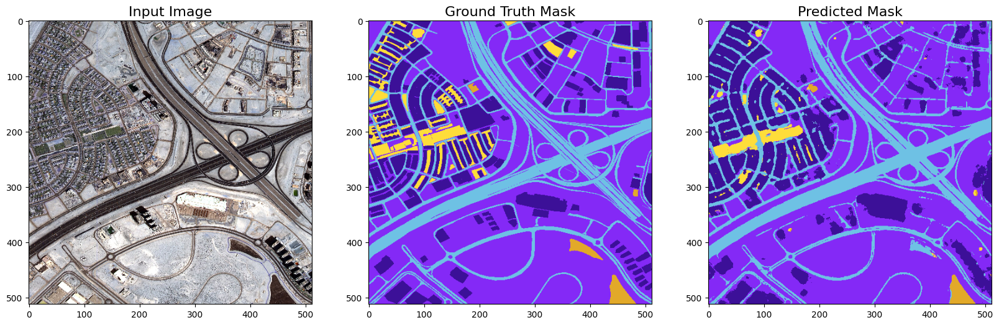

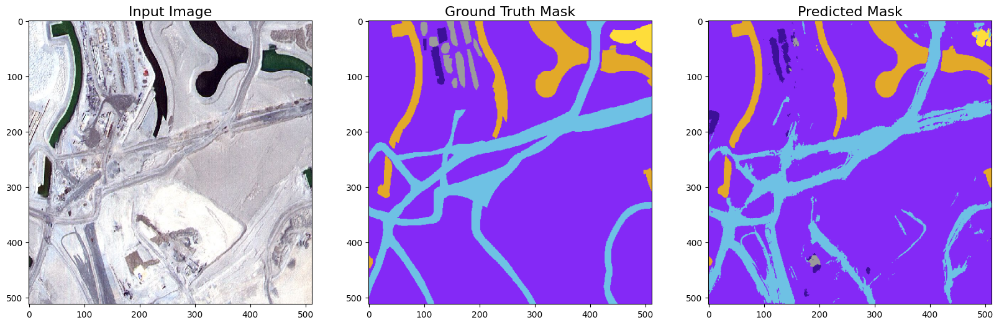

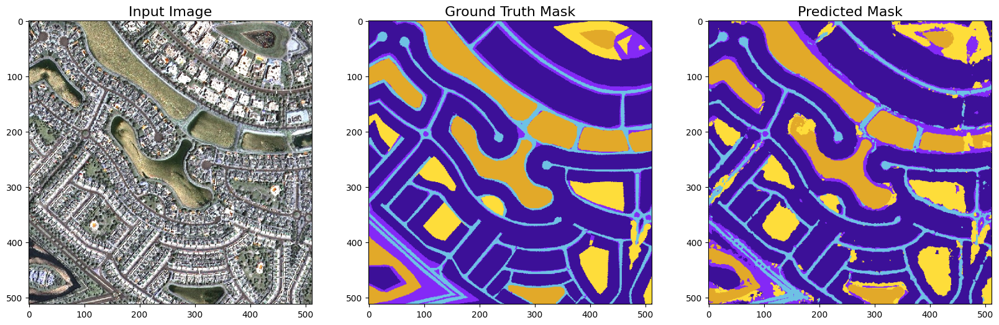

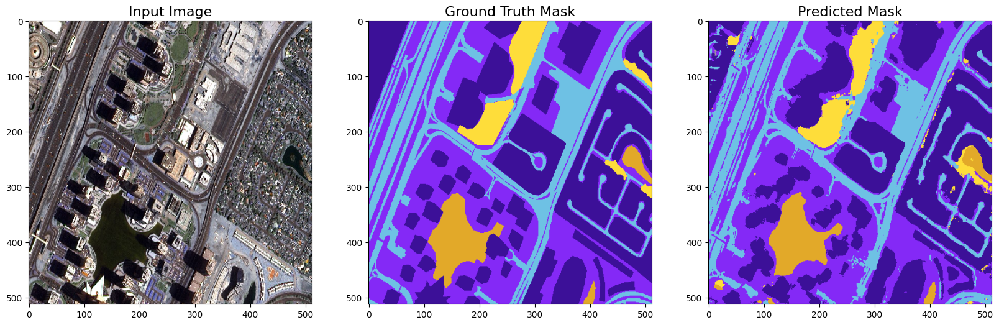

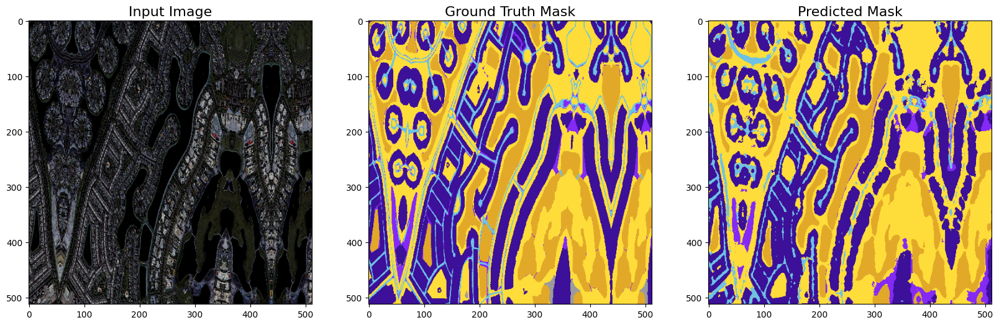

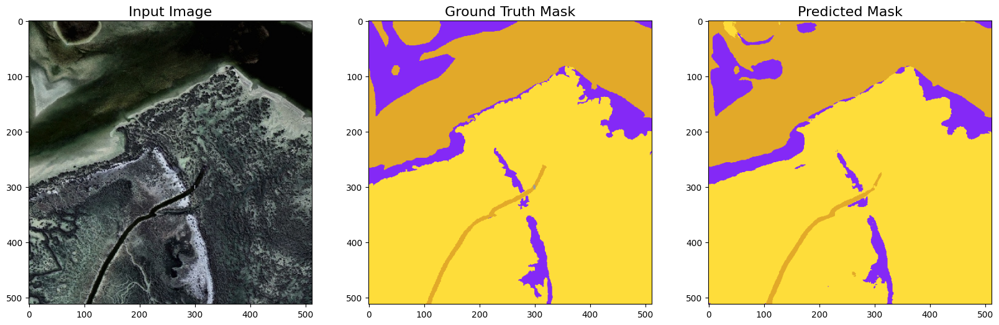

1/1 [==============================] - 0s 42ms/step


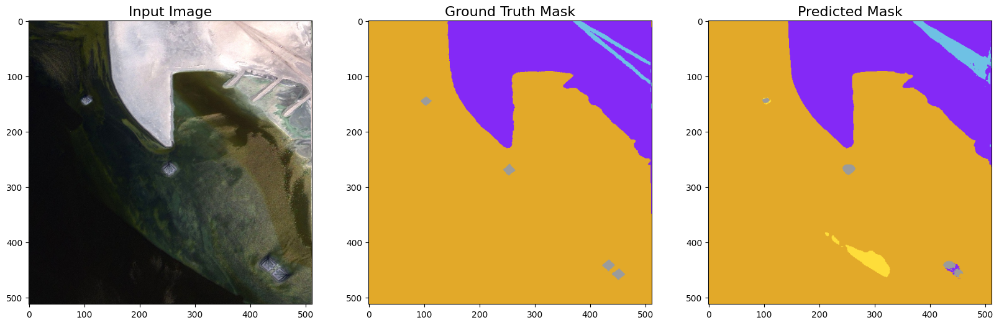

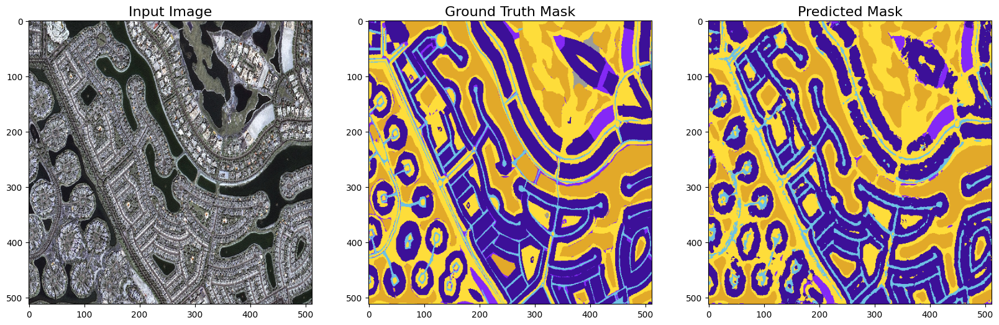

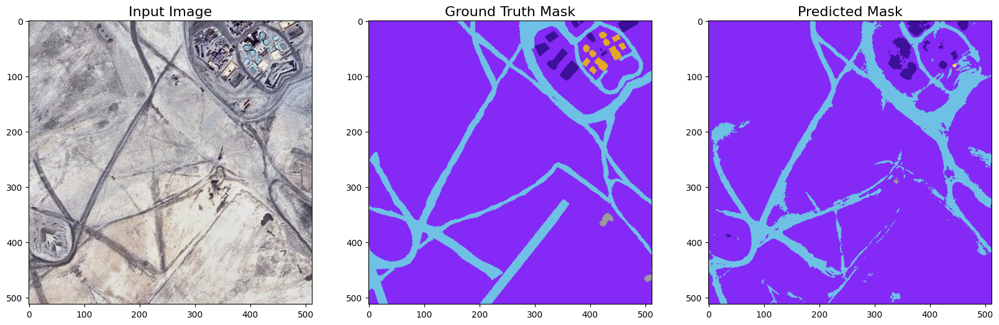

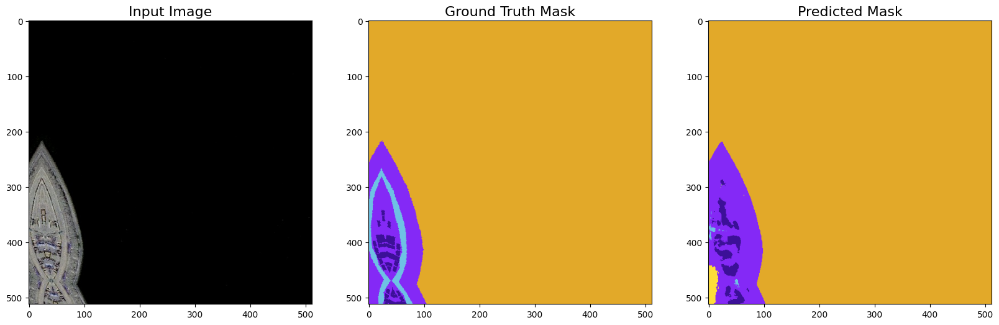

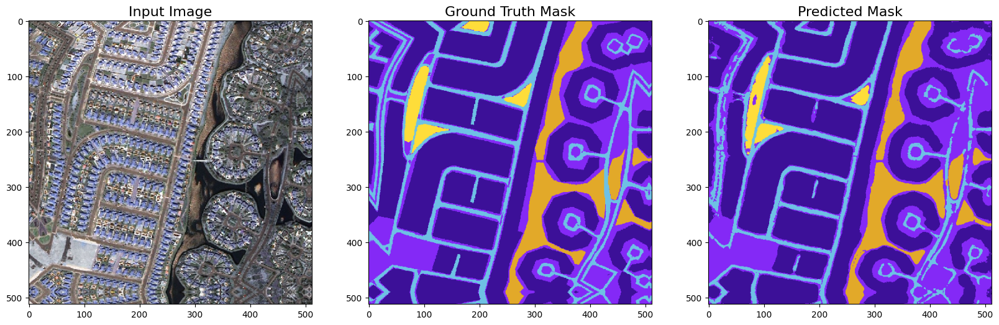

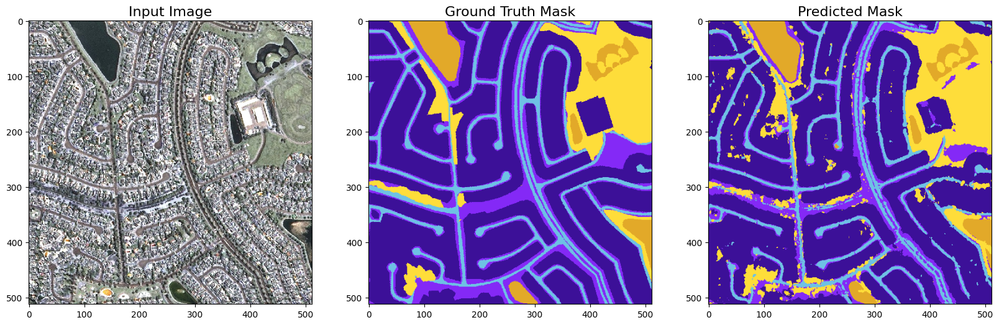

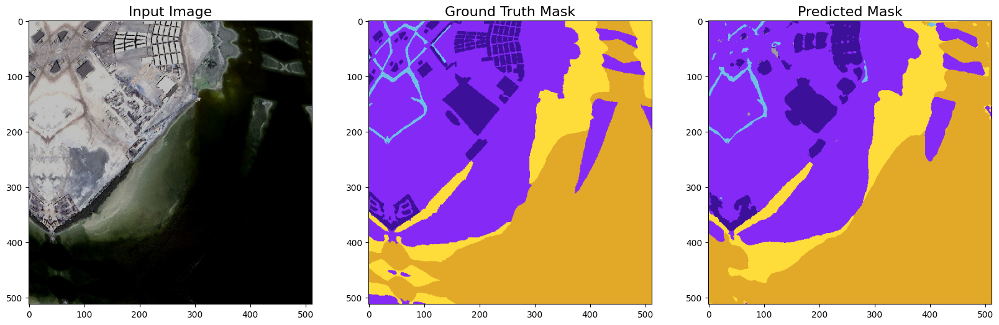

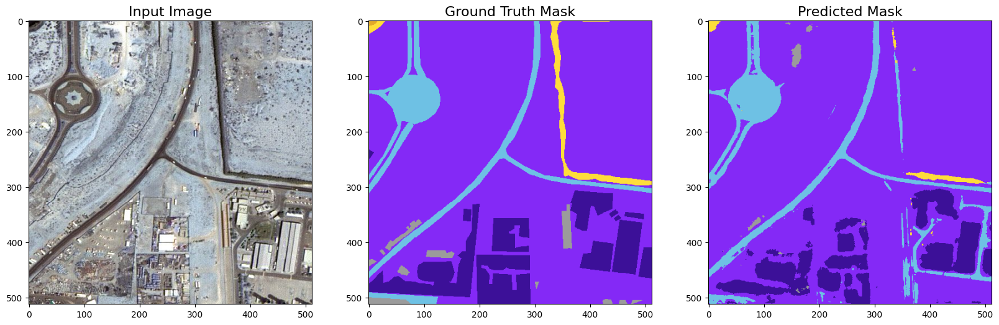

In [ ]:
count = 0
for i in range(2):
    batch_img,batch_mask = next(testing_gen)
    pred_all= model.predict(batch_img)
    np.shape(pred_all)

    for j in range(0,np.shape(pred_all)[0]):
        count += 1
        fig = plt.figure(figsize=(20,8))

        ax1 = fig.add_subplot(1,3,1)
        ax1.imshow(batch_img[j])
        ax1.set_title('Input Image', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax1.grid(False)

        ax2 = fig.add_subplot(1,3,2)
        ax2.set_title('Ground Truth Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax2.imshow(onehot_to_rgb(batch_mask[j],id2code))
        ax2.grid(False)

        ax3 = fig.add_subplot(1,3,3)
        ax3.set_title('Predicted Mask', fontdict={'fontsize': 16, 'fontweight': 'medium'})
        ax3.imshow(onehot_to_rgb(pred_all[j],id2code))
        ax3.grid(False)

        plt.savefig('./prediction_{}.png'.format(count), facecolor= 'w', transparent= False, bbox_inches= 'tight', dpi= 200)
        plt.show()

In [ ]:
from sklearn.metrics import precision_score, recall_score, f1_score

def evaluate_metrics(y_true, y_pred):
    # Flatten the masks
    y_true_flat = y_true.argmax(axis=-1).flatten()
    y_pred_flat = y_pred.argmax(axis=-1).flatten()

    # Compute precision, recall, and F1-score
    precision = precision_score(y_true_flat, y_pred_flat, average='macro')
    recall = recall_score(y_true_flat, y_pred_flat, average='macro')
    f1 = f1_score(y_true_flat, y_pred_flat, average='macro')

    return precision, recall, f1

# Assuming pred_all contains the predicted masks and batch_mask contains the ground truth masks
# Assuming pred_all and batch_mask are in one-hot encoded format
precision, recall, f1 = evaluate_metrics(batch_mask, pred_all)
print("Precision: {:.2f}".format(precision))
print("Recall: {:.2f}".format(recall))
print("F1-score: {:.2f}".format(f1))


Precision: 0.78
Recall: 0.74
F1-score: 0.75


## Model's Activations (Outputs) Visualization

In [ ]:
# image = load_img('../input/augmented-dubai-aerial-imagery-dataset/val_images/val/image_t4_008.jpg', target_size= (512, 512))
image = load_img('/content/drive/MyDrive/Colab Notebooks/Datasets/satellite/DubaiDataset/test_images/image_t7_005.jpg', target_size= (512, 512))
image = img_to_array(image)
image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
image = preprocess_input(image)
y_hat = model.predict(image)

1/1 [==============================] - 6s 6s/step


In [ ]:
layers=['conv2d', 'conv2d_4', 'conv2d_8', 'conv2d_10', 'conv2d_22', 'conv2d_28', 'conv2d_34', 'conv2d_40', 'conv2d_52', 'conv2d_61', 'conv2d_67', 'conv2d_70']

conv2d (1, 64, 64, 512) 


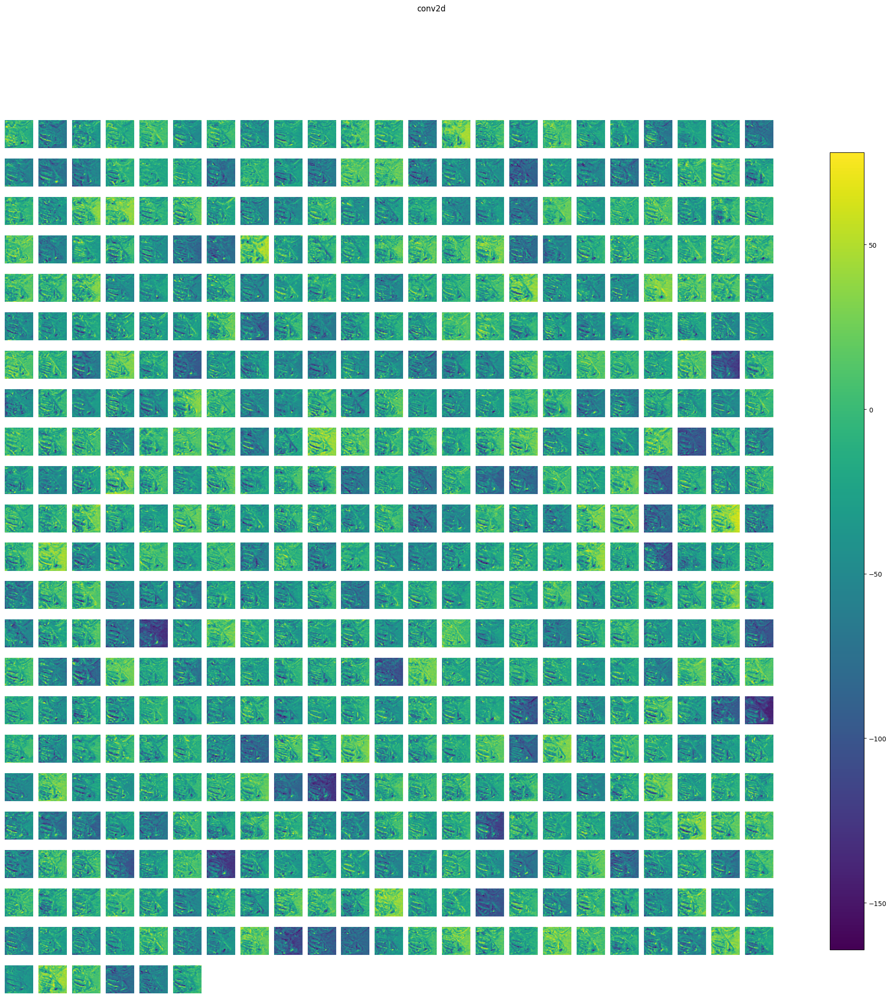

conv2d_4 (1, 256, 256, 128) 


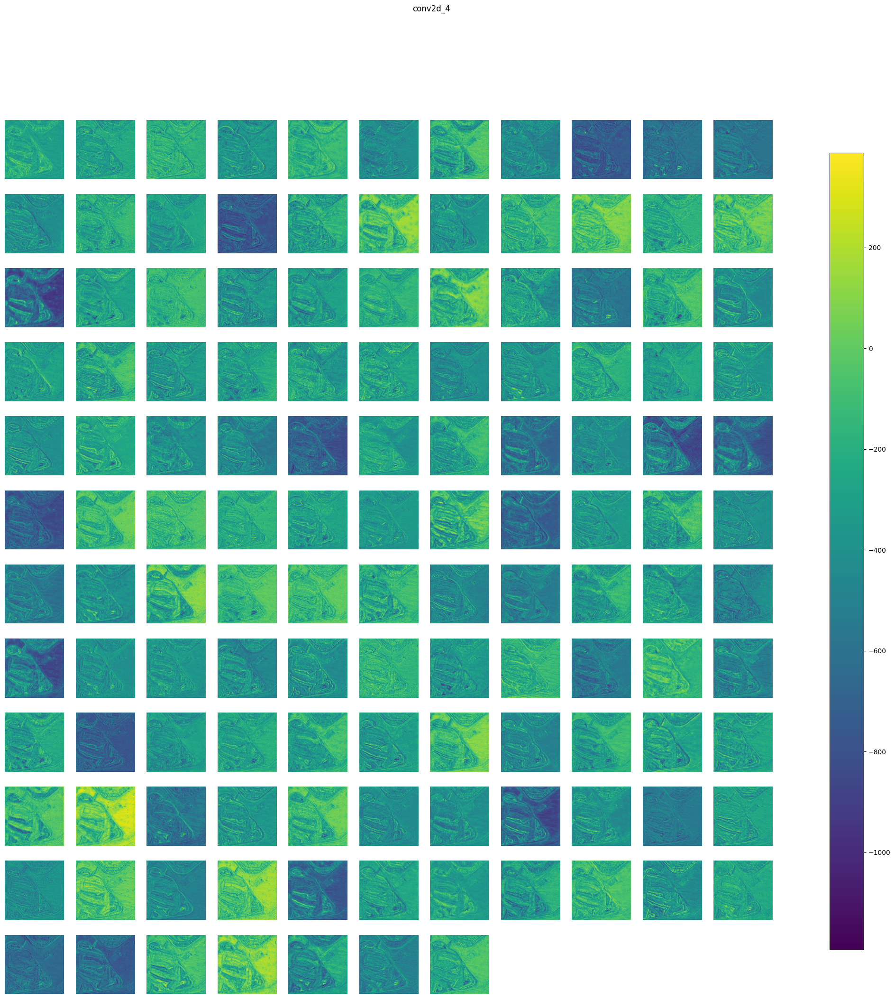

conv2d_8 (1, 512, 512, 6) 


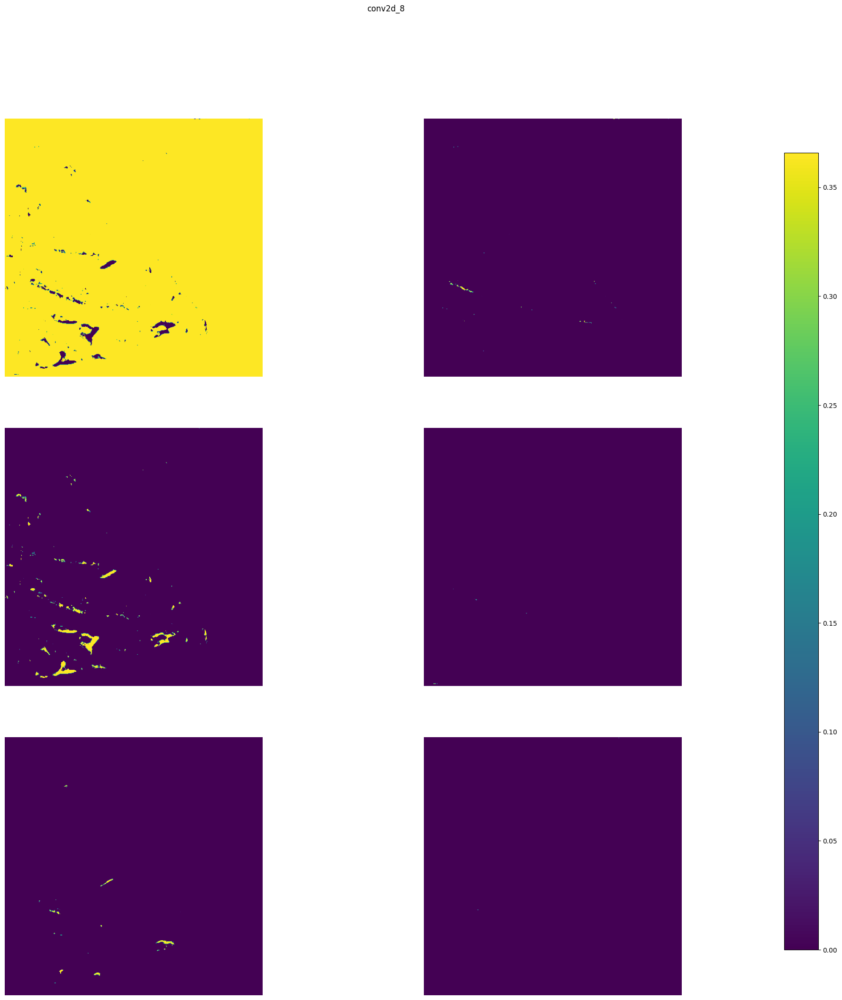

In [ ]:
activations= keract.get_activations(model, image, layer_names= layers, nodes_to_evaluate= None, output_format= 'simple', auto_compile= True)
keract.display_activations(activations, cmap='viridis', save= False, directory= './activations')